In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (24, 16)
import datetime
import seaborn as sns
import os

In [2]:
def import_files(path="data/processed_data"):
    file_dfs = {}
    target_values = []
    subject_count = 1
    for subject_type in os.listdir(path):
        for subject_ID in os.listdir(f"{path}/{subject_type}"):
            target = 1 if subject_type.split("_")[0] == "diabetes" or "diabetes" in subject_ID.split("_")  else  0
            try:
                df = pd.read_csv(f"{path}/{subject_type}/{subject_ID}/sensor_data/resampled_sensor_data.csv")
                df["Time"] = pd.to_datetime(df["Time"], format="%Y-%m-%d %H:%M:%S")
                file_dfs[f"subject_{subject_count:02}"] = df
                target_values.append(target)
                subject_count+=1
            except FileNotFoundError:
                print(f"Could not open file: {path}/{subject_type}/{subject_ID}/sensor_data/resampled_sensor_data.csv")

    return file_dfs, target_values

In [3]:
def plot_violinplot(df, title, ylabel="Subject ID", xlabel="Hours"):
    fontdict = {"fontsize":40}
    plt.title(title)
    plt.title(title,fontdict)
    plt.ylabel(ylabel,fontdict)
    plt.xlabel(xlabel,fontdict)
    sns.violinplot(data=df, width = 0.5,orient="horizontal",) 
    
def plot_lineplot(df,colName, title, xlabel,datetime_range,resample_freq="t", ):
    sns.lineplot(data=df[datetime_range].resample(resample_freq))
    plt.show();

def plot_from_dict(dfs, colName, violin_plot=True):
    my_pd = pd.DataFrame()
    for key in dfs:
        current_pd = pd.DataFrame(file_dfs[key][colName].values, columns=[key], index = file_dfs[key]["Time"])
        my_pd = my_pd.join(current_pd, how="outer")
    if violin_plot:
        plot_violinplot(my_pd, f"{colName} For All Subjects", ylabel="Subject ID", xlabel=colName)
    else:
        return my_pd

In [4]:
file_dfs, target_values = import_files()

In [5]:
file_dfs.keys()

dict_keys(['subject_01', 'subject_02', 'subject_03', 'subject_04', 'subject_05', 'subject_06', 'subject_07', 'subject_08', 'subject_09', 'subject_10', 'subject_11'])

In [6]:
target_values

[1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0]

C:\Users\PC\anaconda3\envs\CA4016\lib\site-packages\seaborn\categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


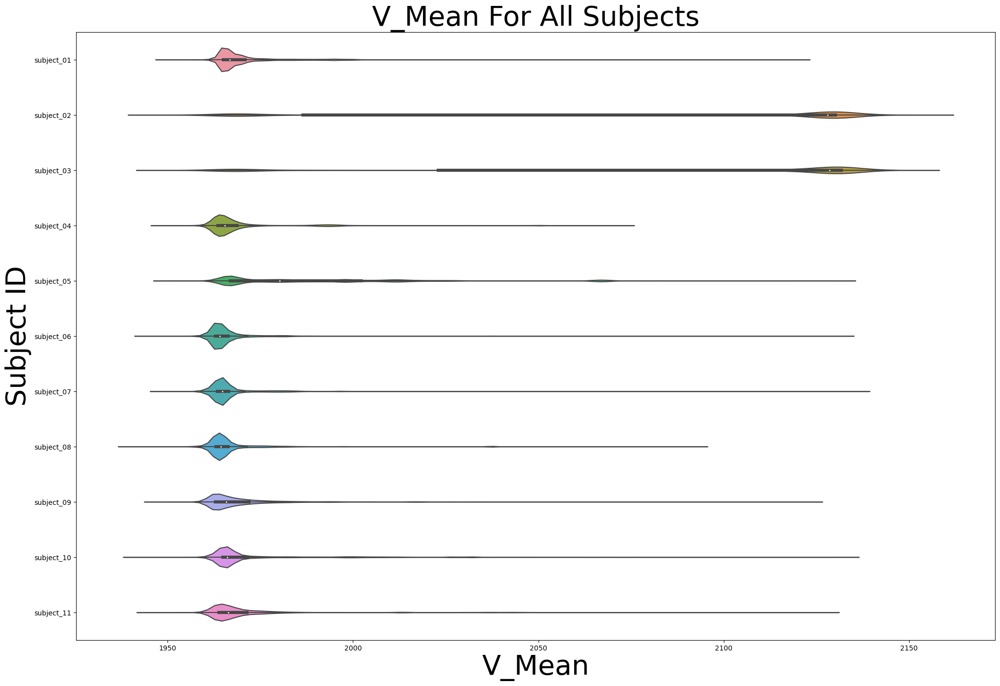

In [7]:
plot_from_dict(file_dfs, "V_Mean")

C:\Users\PC\anaconda3\envs\CA4016\lib\site-packages\seaborn\categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


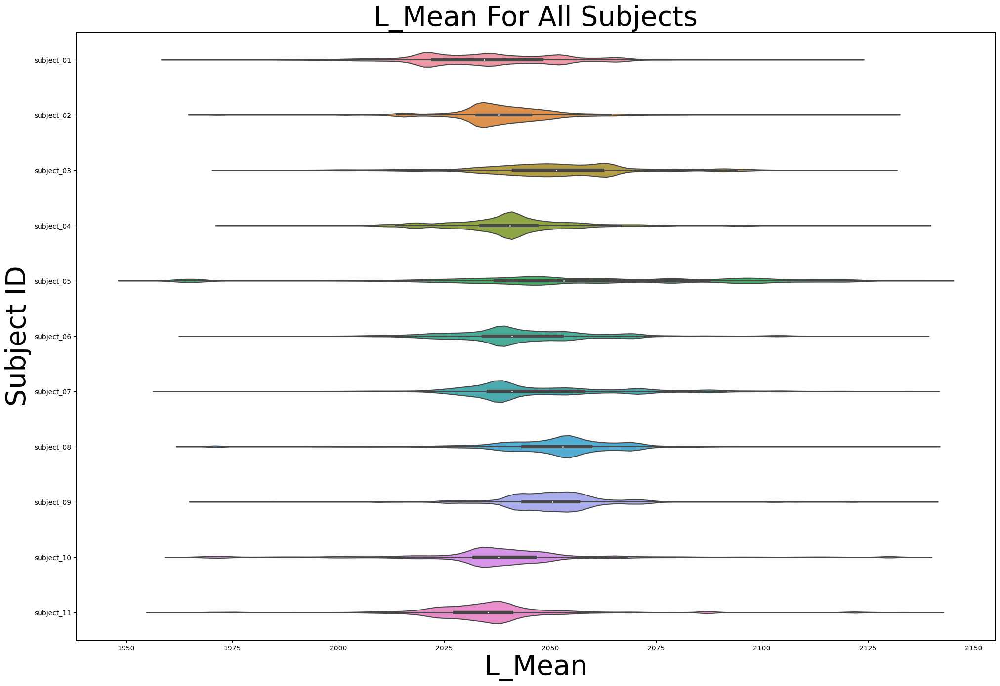

In [8]:
plot_from_dict(file_dfs, "L_Mean")

C:\Users\PC\anaconda3\envs\CA4016\lib\site-packages\seaborn\categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


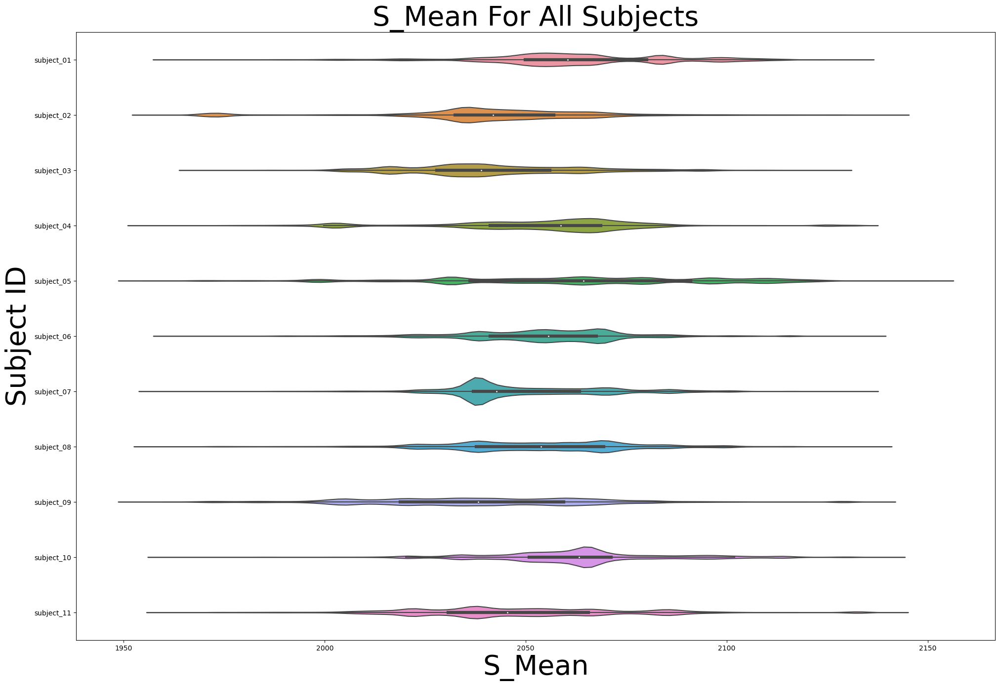

In [9]:
plot_from_dict(file_dfs, "S_Mean")

C:\Users\PC\anaconda3\envs\CA4016\lib\site-packages\seaborn\categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


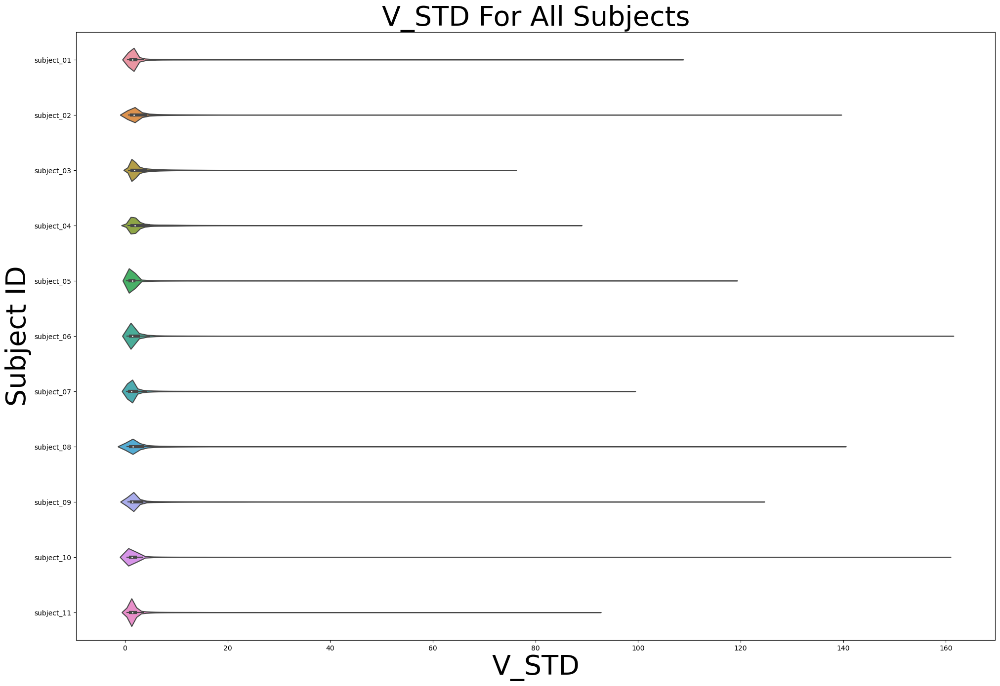

In [10]:
plot_from_dict(file_dfs, "V_STD")

C:\Users\PC\anaconda3\envs\CA4016\lib\site-packages\seaborn\categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


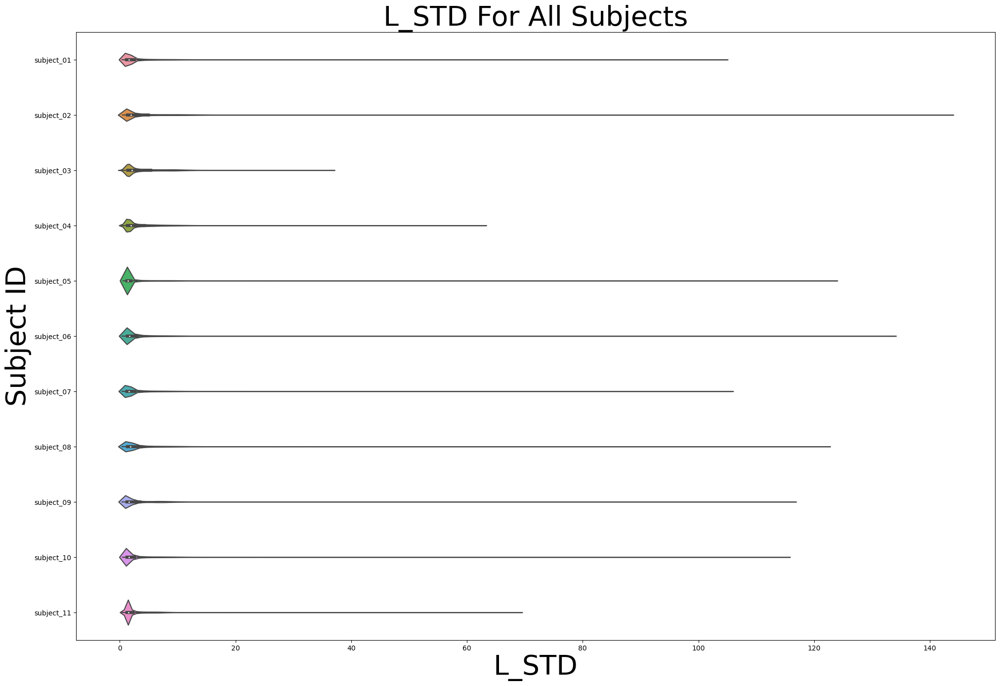

In [11]:
plot_from_dict(file_dfs, "L_STD")

C:\Users\PC\anaconda3\envs\CA4016\lib\site-packages\seaborn\categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


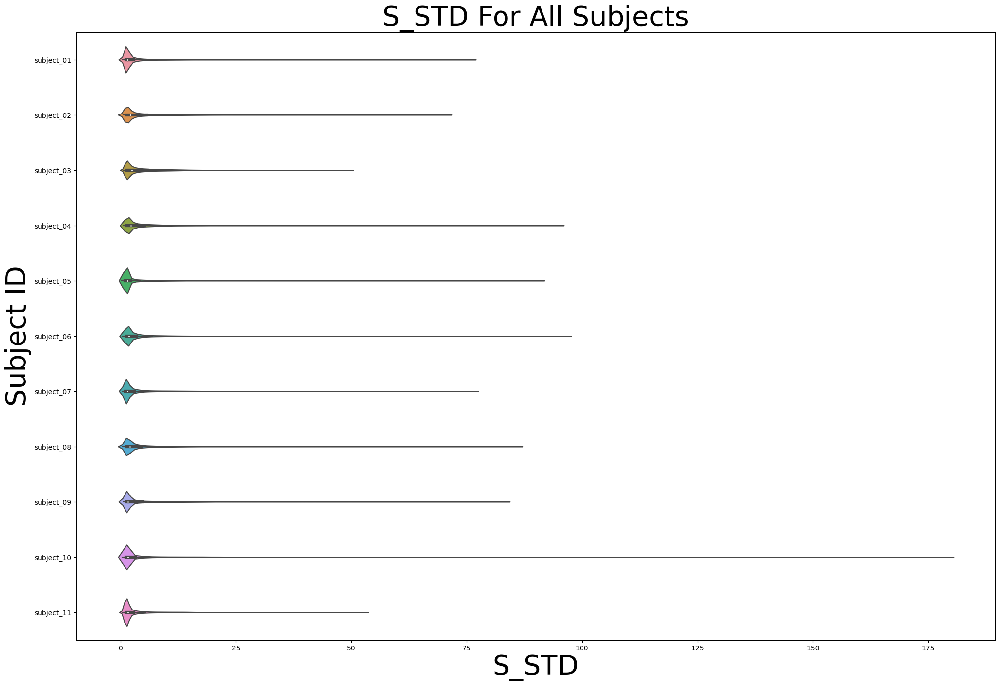

In [12]:
plot_from_dict(file_dfs, "S_STD")

C:\Users\PC\anaconda3\envs\CA4016\lib\site-packages\seaborn\categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


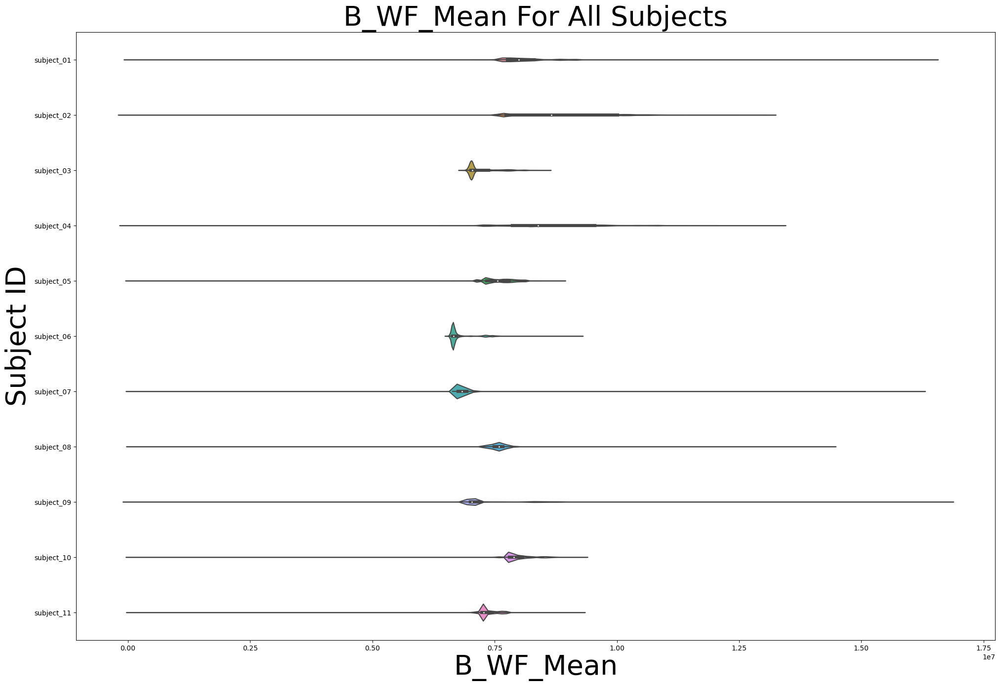

In [13]:
plot_from_dict(file_dfs, "B_WF_Mean")

C:\Users\PC\anaconda3\envs\CA4016\lib\site-packages\seaborn\categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


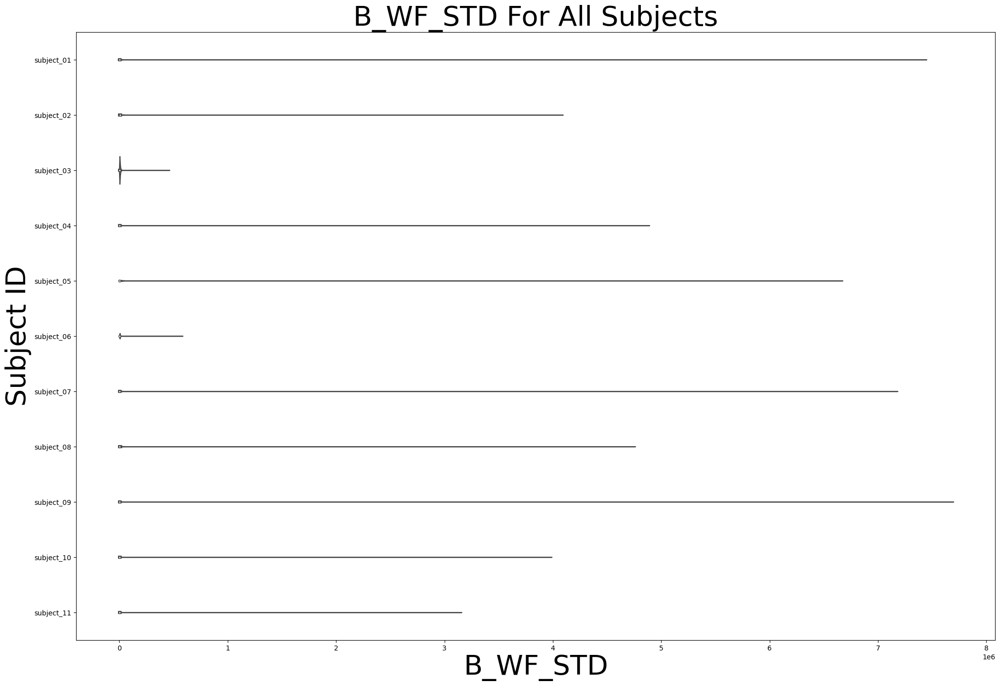

In [14]:
plot_from_dict(file_dfs, "B_WF_STD")

C:\Users\PC\anaconda3\envs\CA4016\lib\site-packages\seaborn\categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


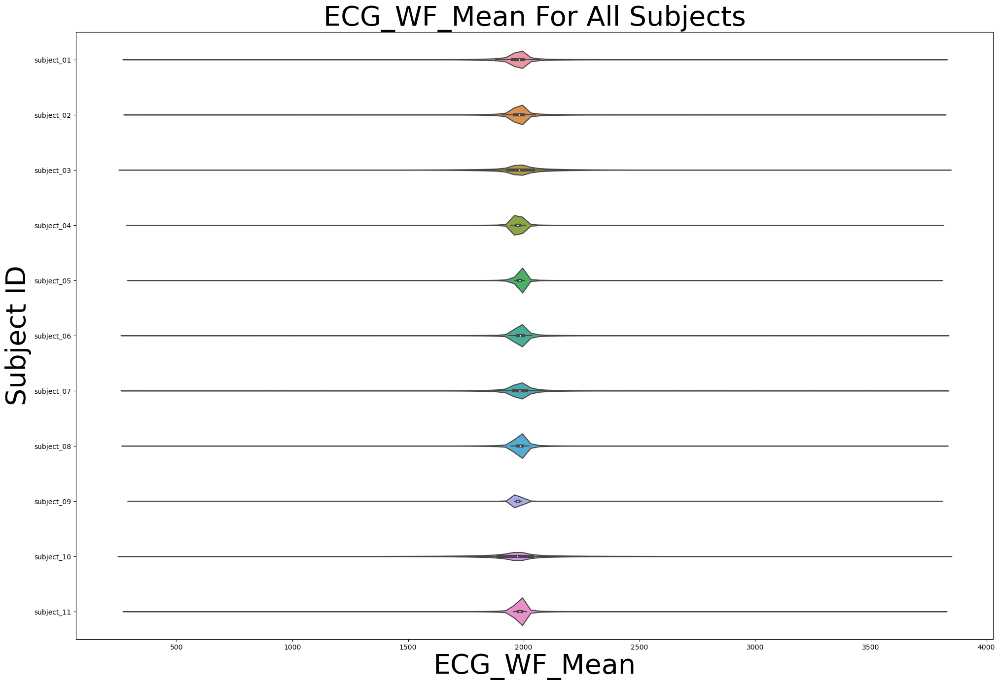

In [15]:
plot_from_dict(file_dfs, "ECG_WF_Mean")

C:\Users\PC\anaconda3\envs\CA4016\lib\site-packages\seaborn\categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


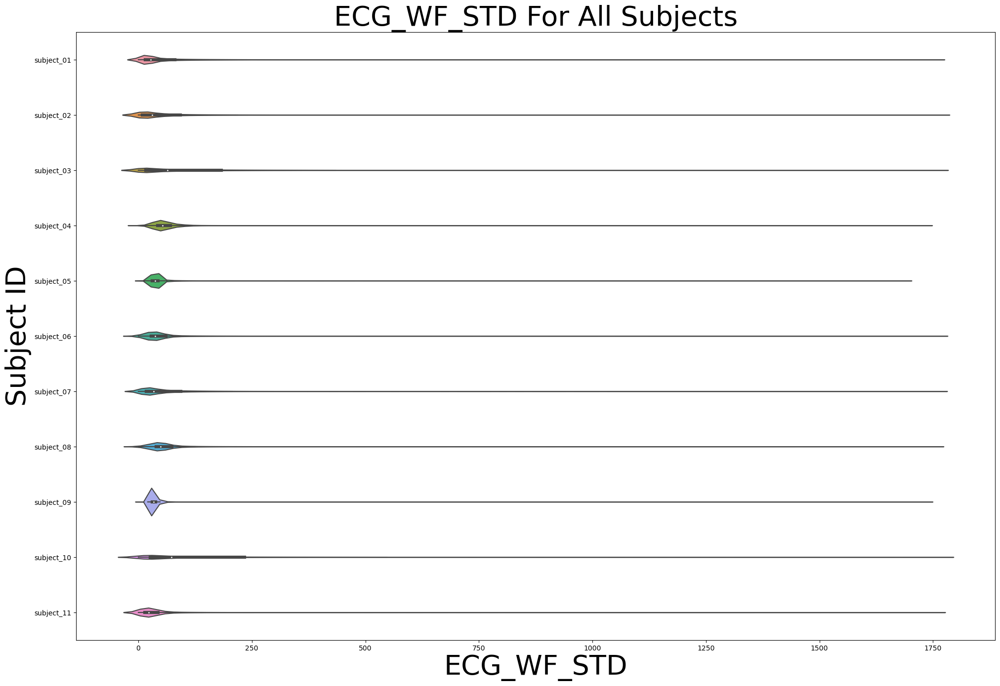

In [16]:
plot_from_dict(file_dfs, "ECG_WF_STD")

### Insights

After looking at all the violin

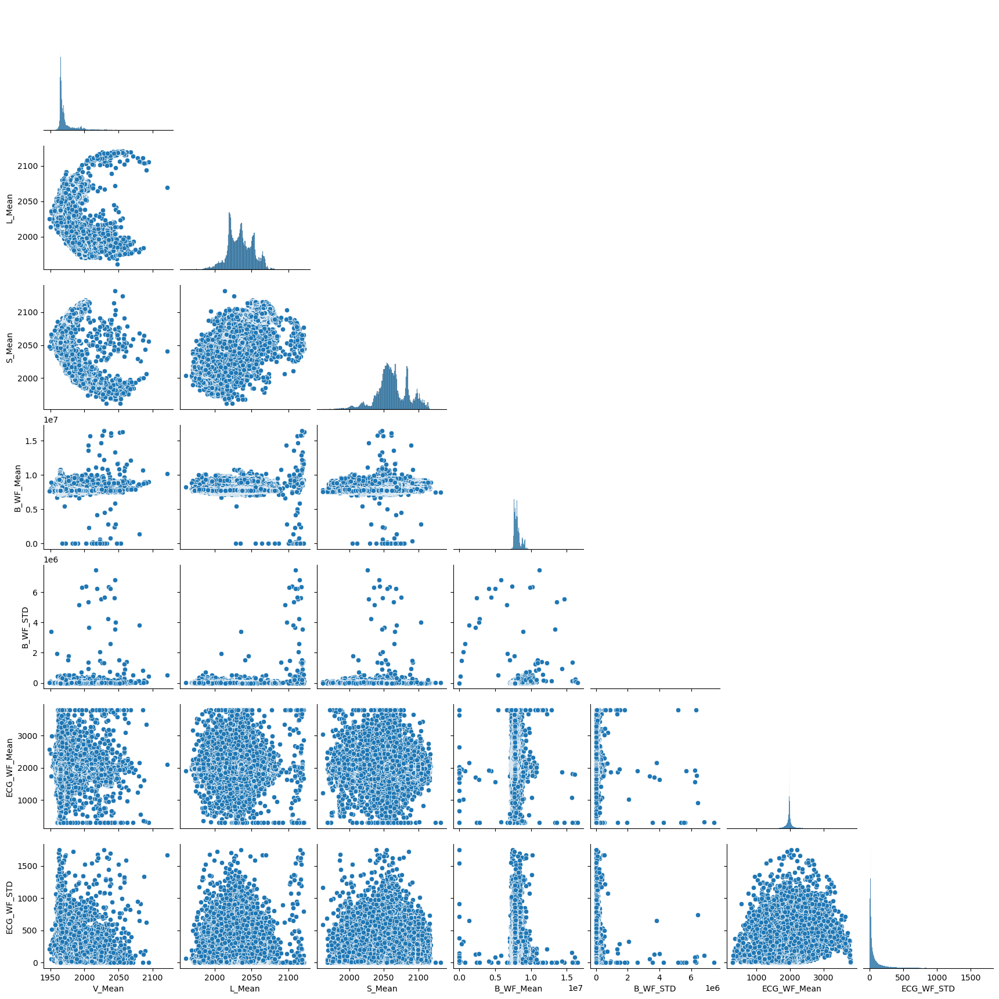

In [17]:
drop_columns= ["Time","V_STD","L_STD","S_STD"]
sns.pairplot(file_dfs["subject_01"].drop(columns=drop_columns), corner=True)

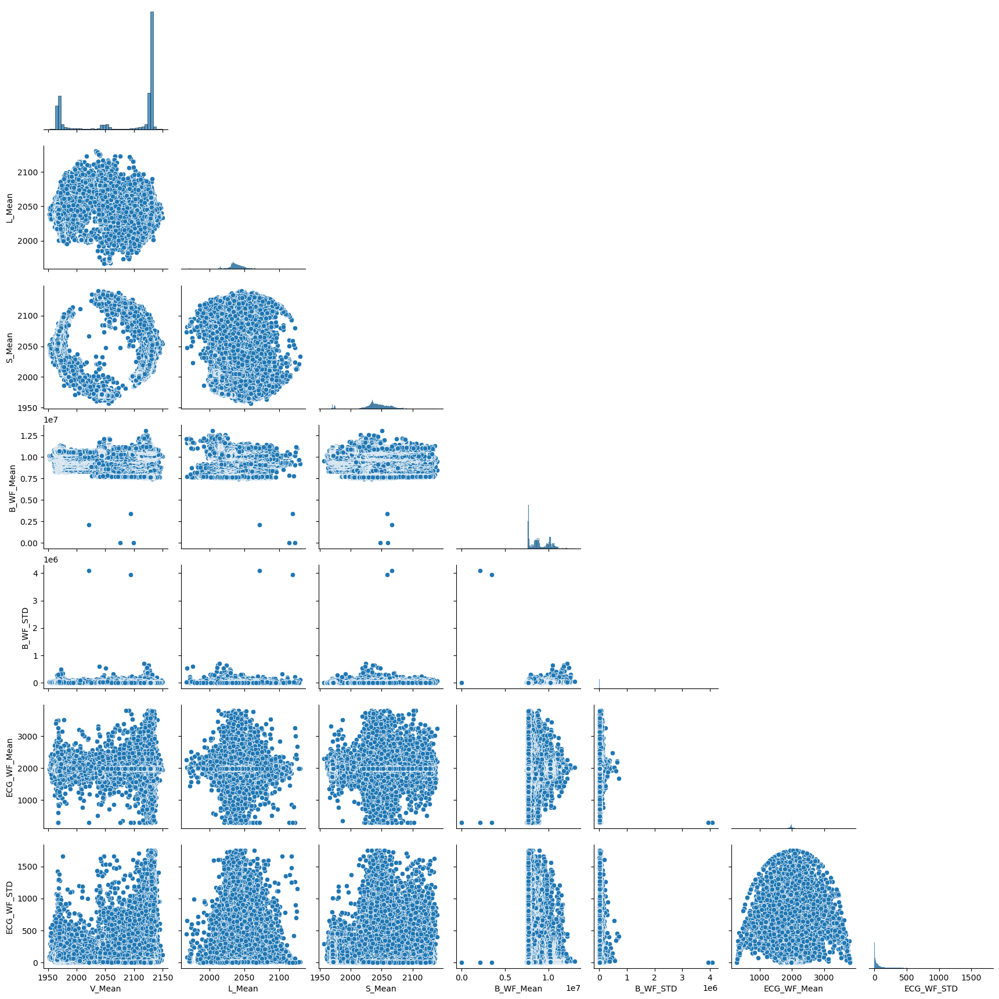

In [18]:
sns.pairplot(file_dfs["subject_02"].drop(columns=drop_columns), corner=True)

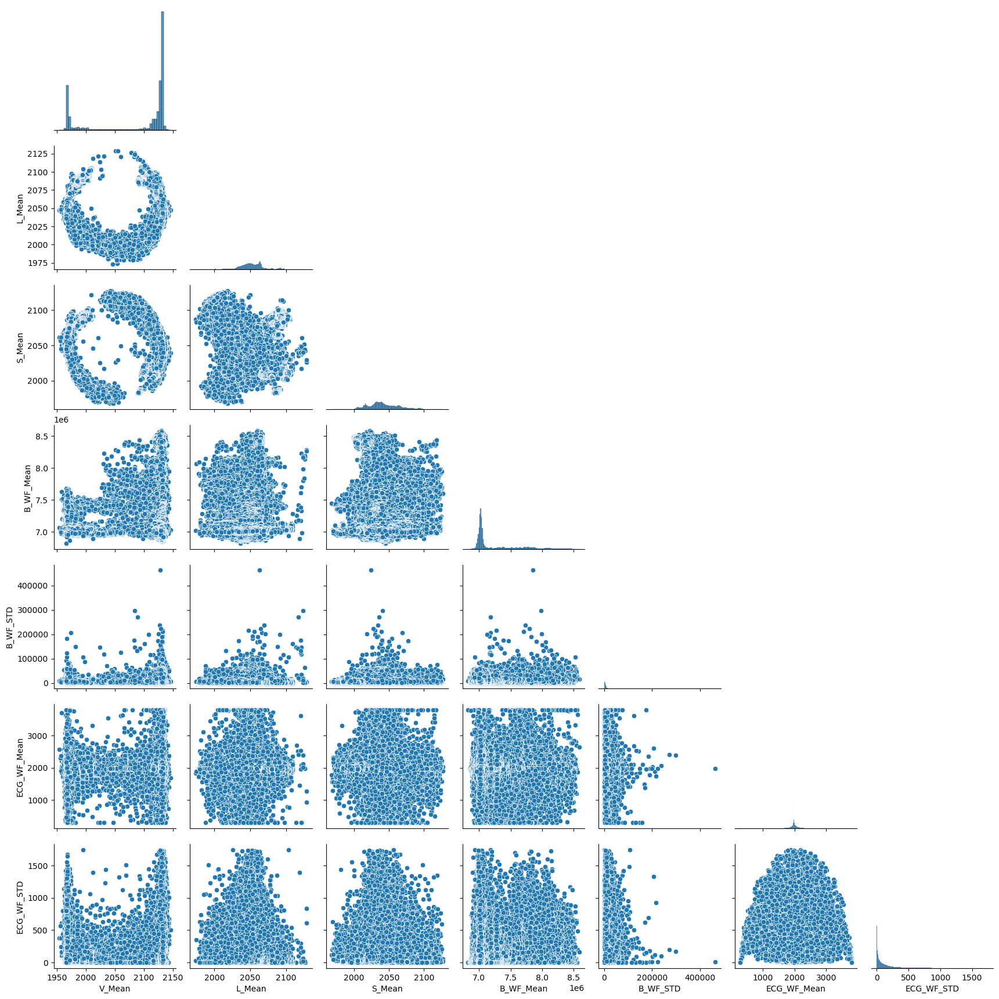

In [19]:
sns.pairplot(file_dfs["subject_03"].drop(columns=drop_columns), corner=True)

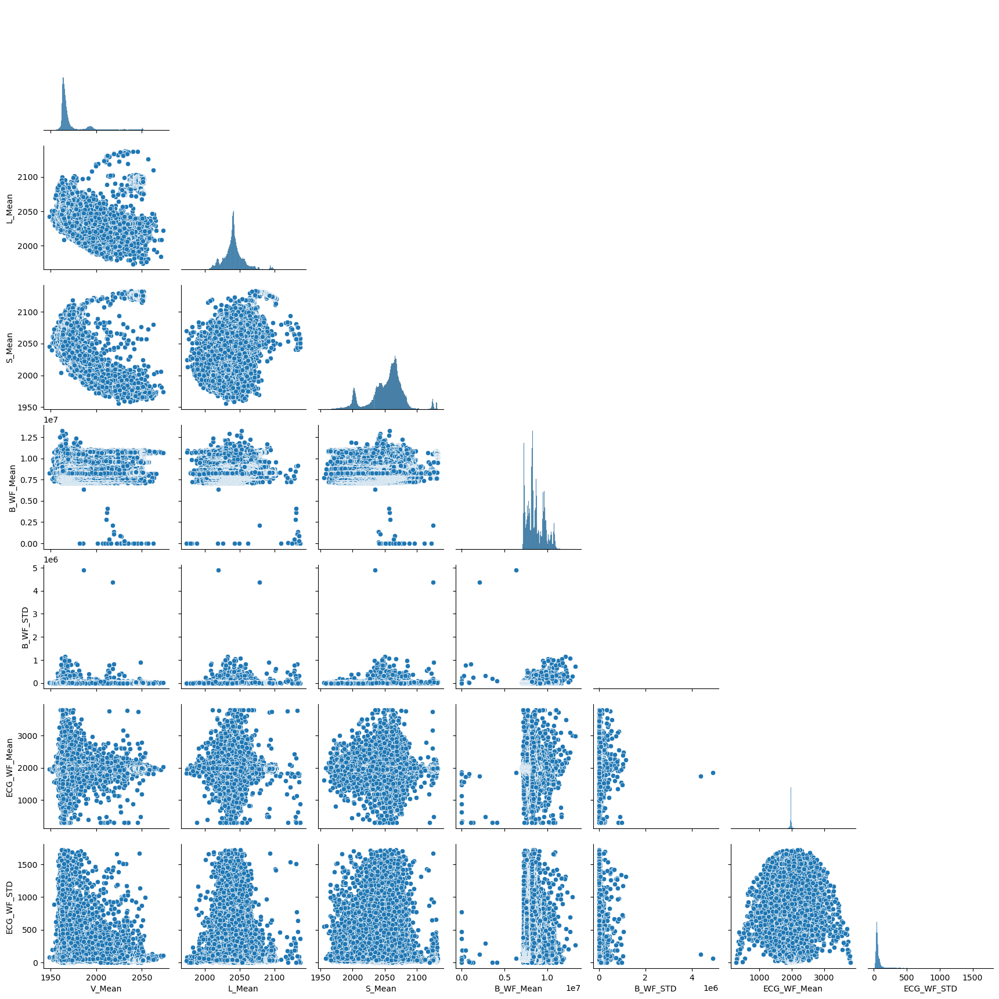

In [20]:
sns.pairplot(file_dfs["subject_04"].drop(columns=drop_columns), corner=True)

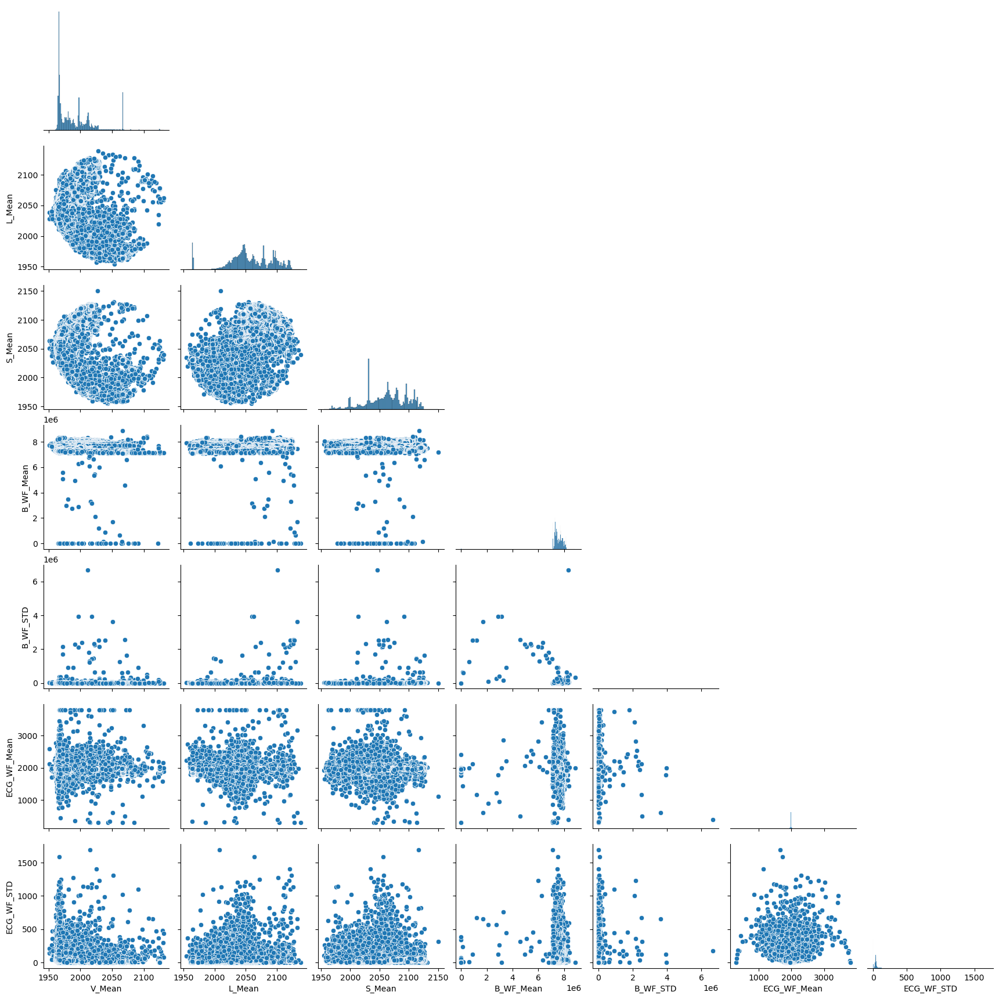

In [21]:
sns.pairplot(file_dfs["subject_05"].drop(columns=drop_columns), corner=True)

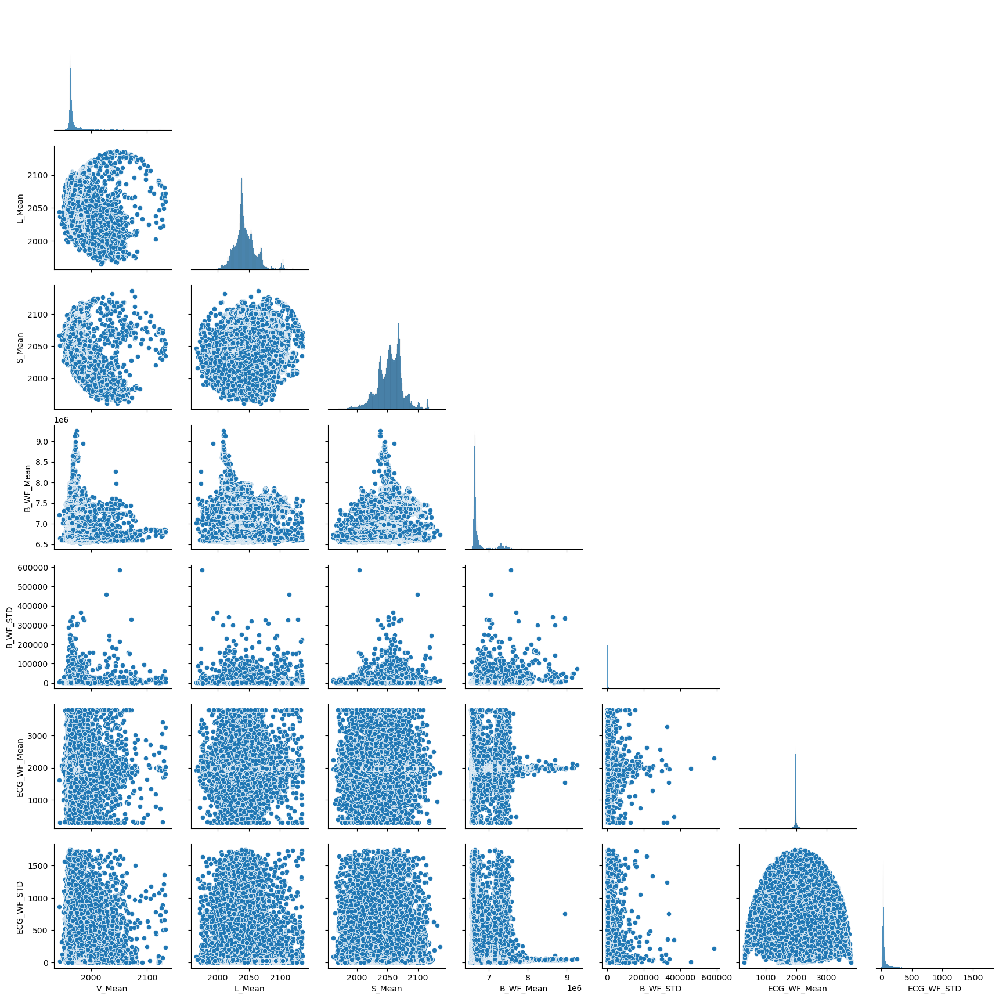

In [22]:
sns.pairplot(file_dfs["subject_06"].drop(columns=drop_columns), corner=True)

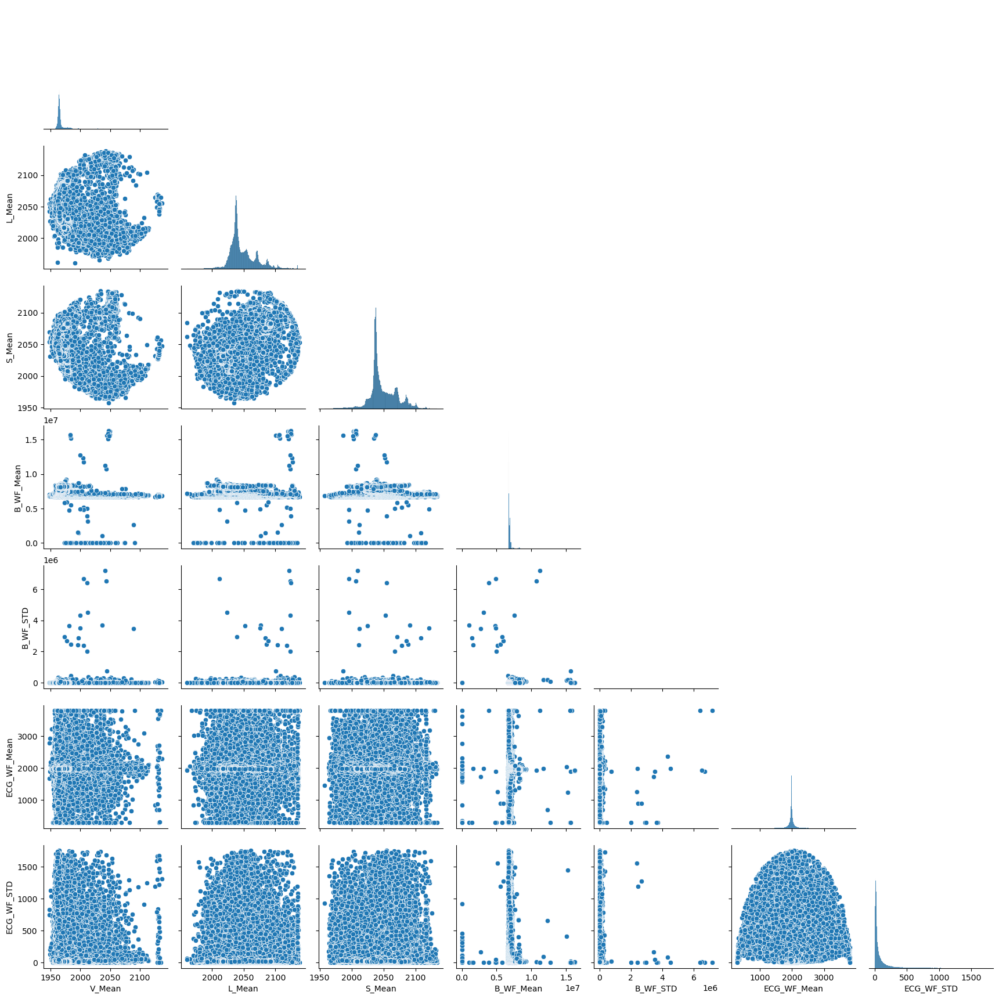

In [23]:
sns.pairplot(file_dfs["subject_07"].drop(columns=drop_columns), corner=True)

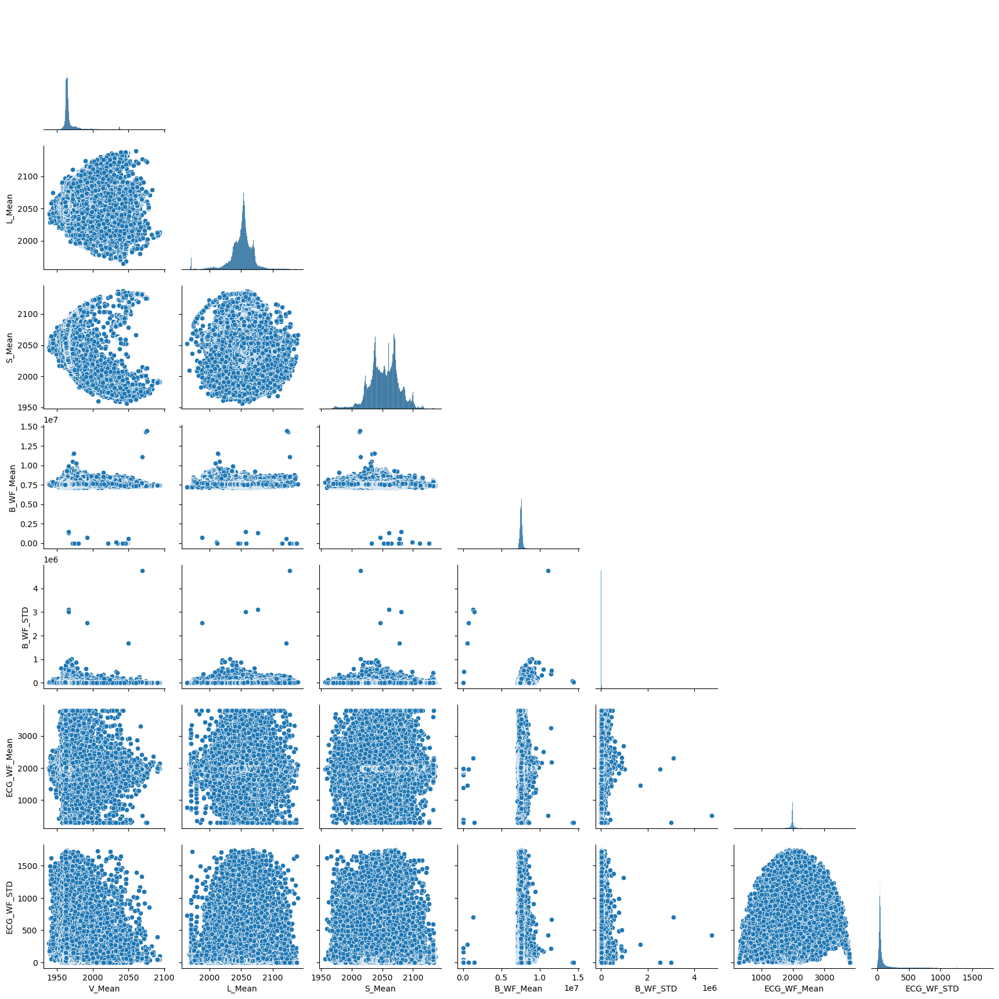

In [24]:
sns.pairplot(file_dfs["subject_08"].drop(columns=drop_columns), corner=True)

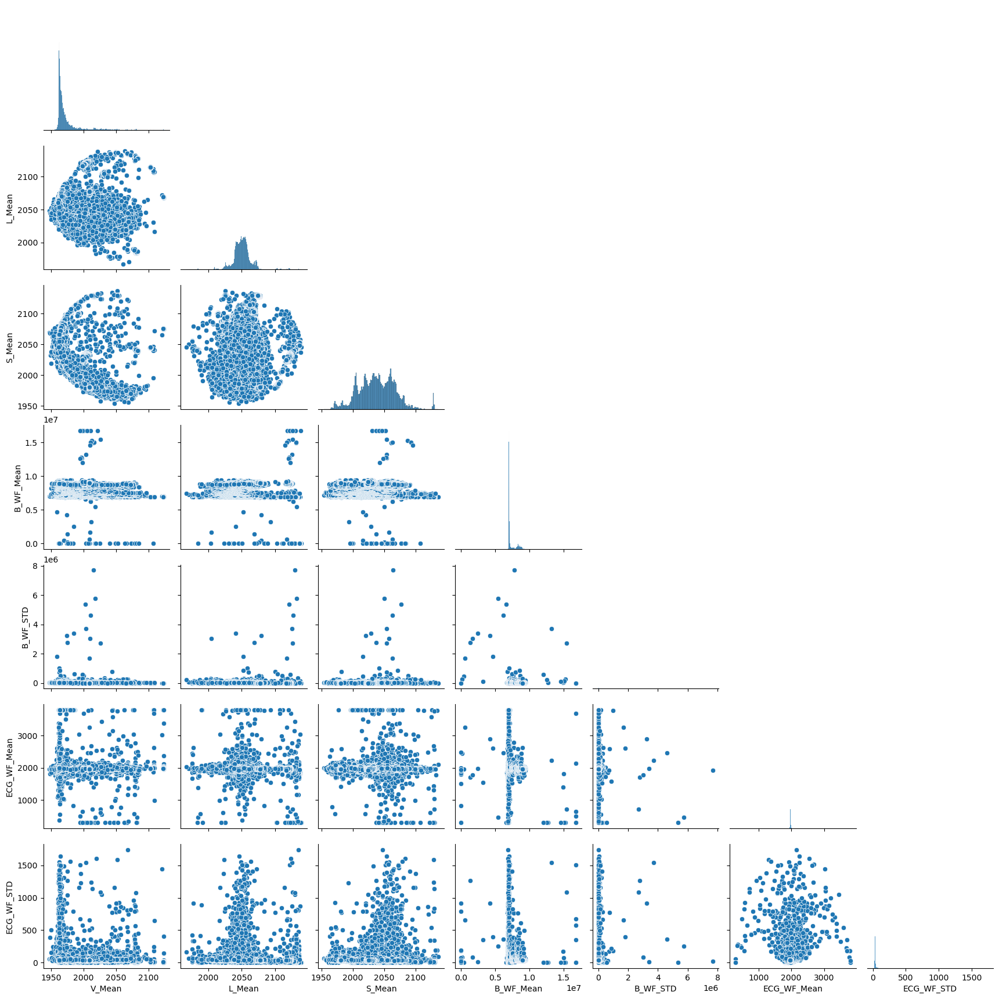

In [25]:
sns.pairplot(file_dfs["subject_09"].drop(columns=drop_columns), corner=True)

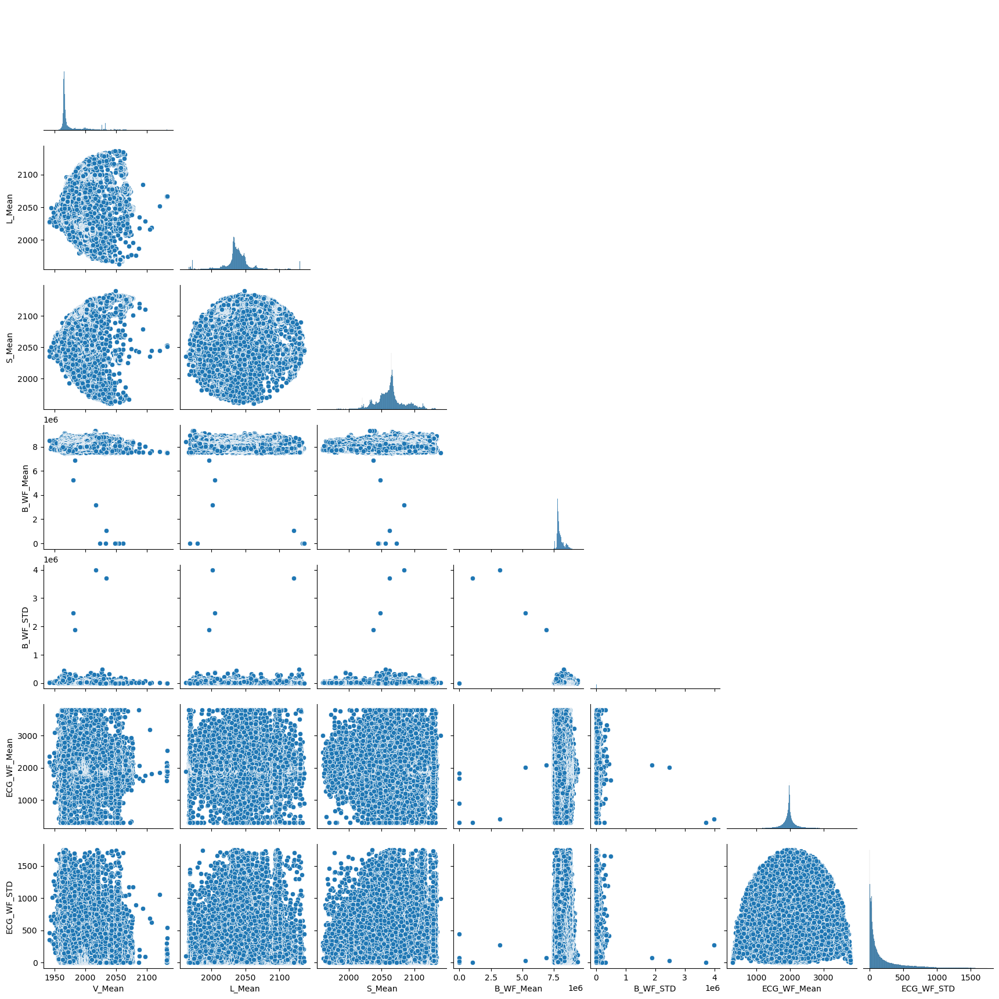

In [26]:
sns.pairplot(file_dfs["subject_10"].drop(columns=drop_columns), corner=True)

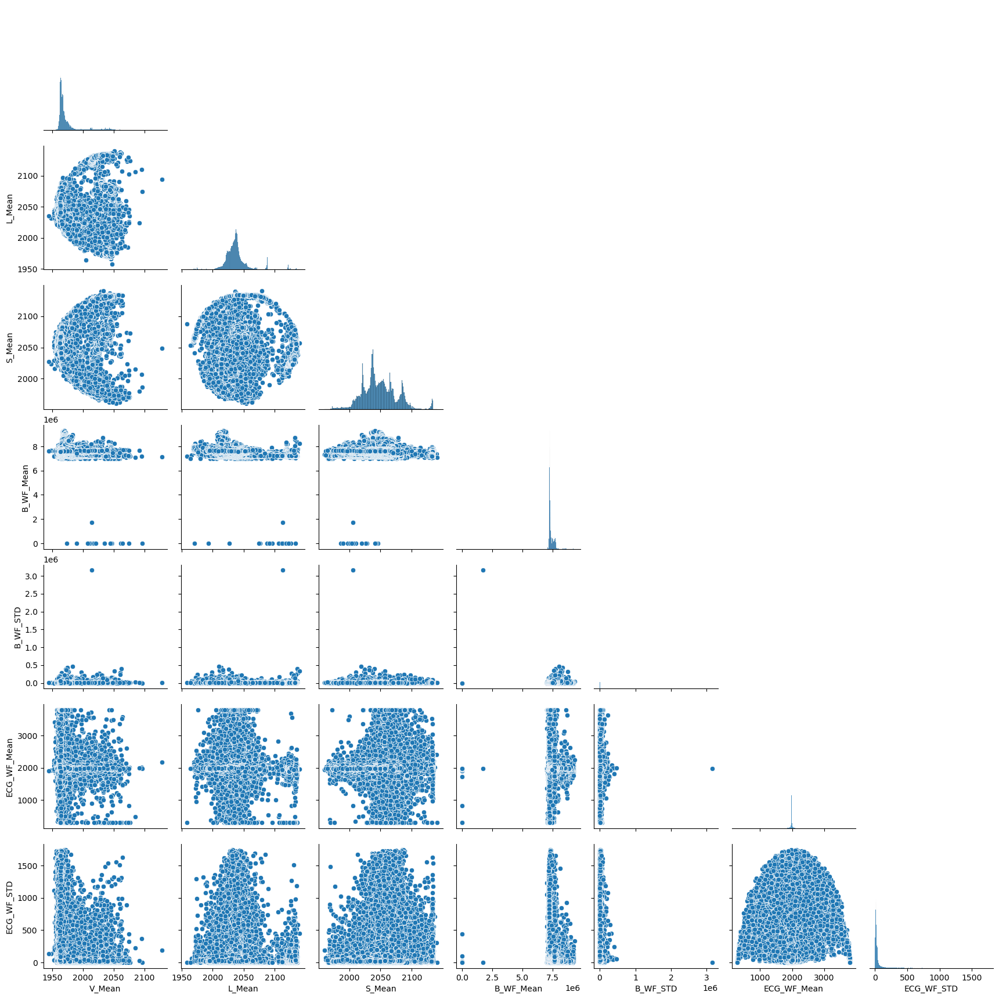

In [27]:
sns.pairplot(file_dfs["subject_11"].drop(columns=drop_columns), corner=True)

In [7]:
def remove_date(datetime):
    return str(datetime.time())

In [78]:
def create_df(file_dfs, colName):
    subject_dict = {}
    mean_values = pd.DataFrame()
    for df in file_dfs:
        df_date_range = pd.date_range(file_dfs[df]["Time"][0].date(), file_dfs[df]["Time"].iloc[-1].date())
        current_subject_df = pd.DataFrame()
        
        for day in df_date_range:
            current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
            current_df.index = current_df.reset_index()["Time"].apply(lambda x: remove_date(x))
            current_subject_df = current_subject_df.join(current_df, how="outer")
        current_subject_df["Mean"] = current_subject_df.T.mean().values
        current_subject_df.index = pd.to_datetime(current_subject_df.index)
        subject_dict[df] = current_subject_df
        mean_values = mean_values.join(current_subject_df[["Mean"]].rename(columns={"Mean":df}), how="outer")
    return subject_dict, mean_values

In [150]:
def plot_fact_grid(my_dict, mean_values, colName, resample_freq="15t"):
    sns.lineplot(data=mean_values.resample(resample_freq).mean().rolling(2, min_periods=1).mean().dropna(thresh=6)).set_title(f"Mean values for {colName} over the four days")
    plt.show();
    fig, axes = plt.subplots(3, 4)
    axes_list = [[i, j] for i in range(3) for j in range(4)]
    fig.suptitle(f"Daily values (resampled to {resample_freq}) for the feature {colName}", fontsize=16);
    for i, subject in enumerate(my_dict):
        axes[axes_list[i][0], axes_list[i][1]].set_title(subject)
        sns.lineplot(data=my_dict[subject].resample(resample_freq).mean().rolling(2, min_periods=1).mean().dropna(thresh=2), ax=axes[axes_list[i][0], axes_list[i][1]])
    plt.show();

In [157]:
V_Mean_df_dict, V_Mean_mean_values = create_df(file_dfs, "V_Mean")

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})


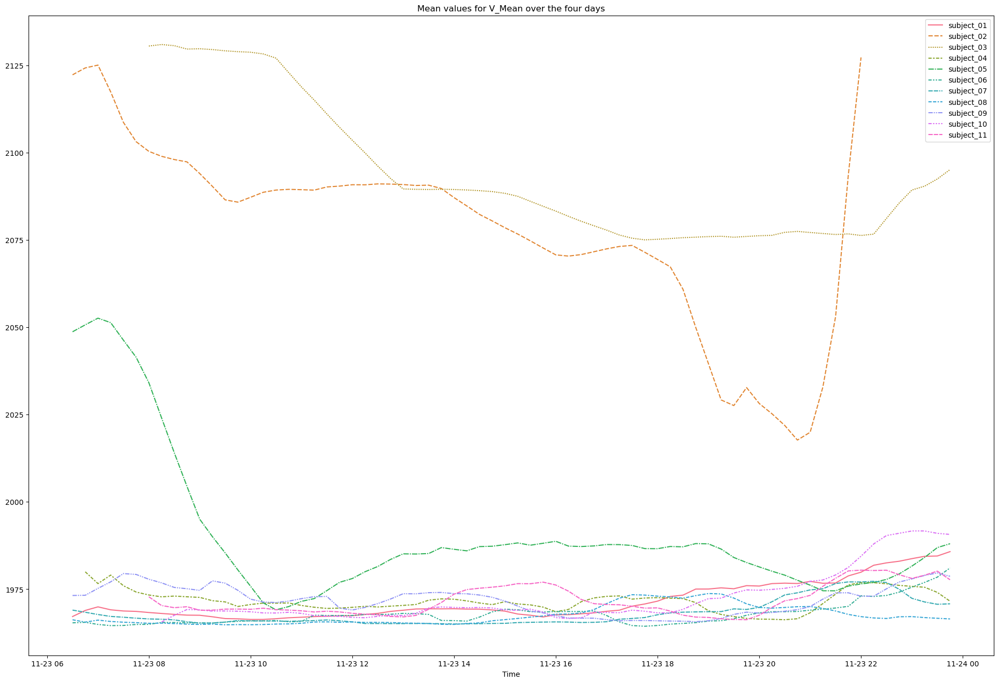

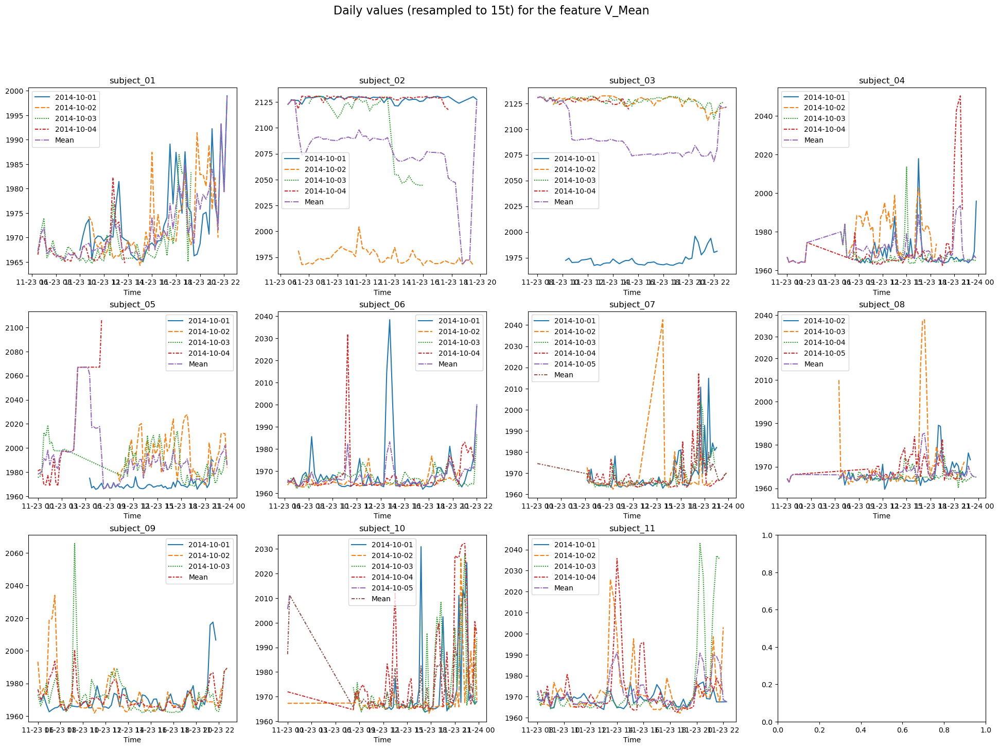

In [158]:
plot_fact_grid(V_Mean_df_dict, V_Mean_mean_values, "V_Mean")

In [127]:
L_Mean_df_dict, L_Mean_mean_values = create_df(file_dfs, "L_Mean")

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})


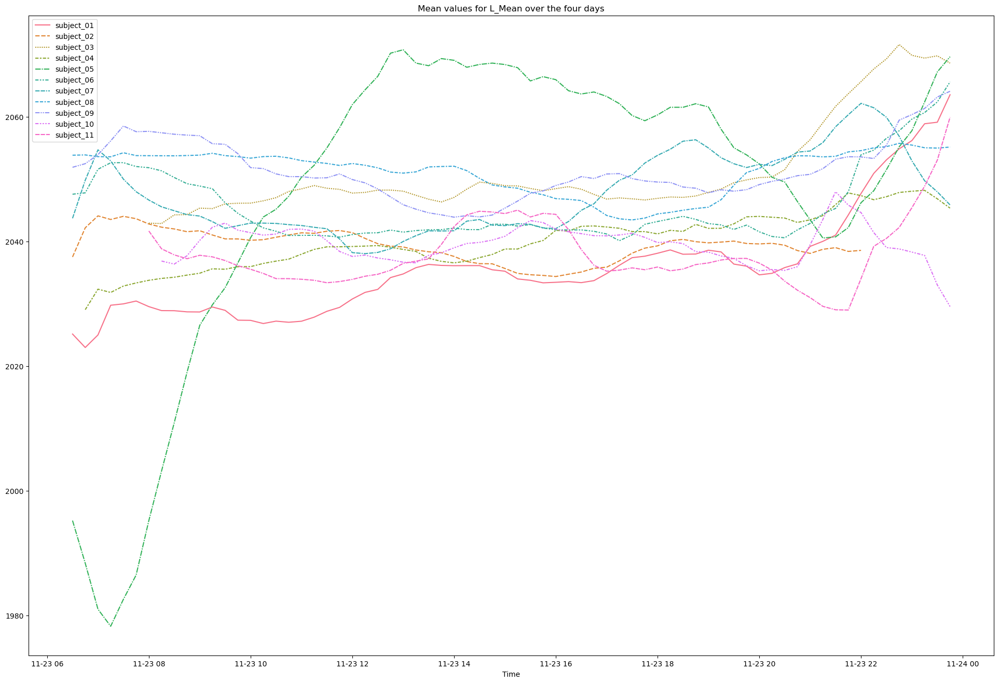

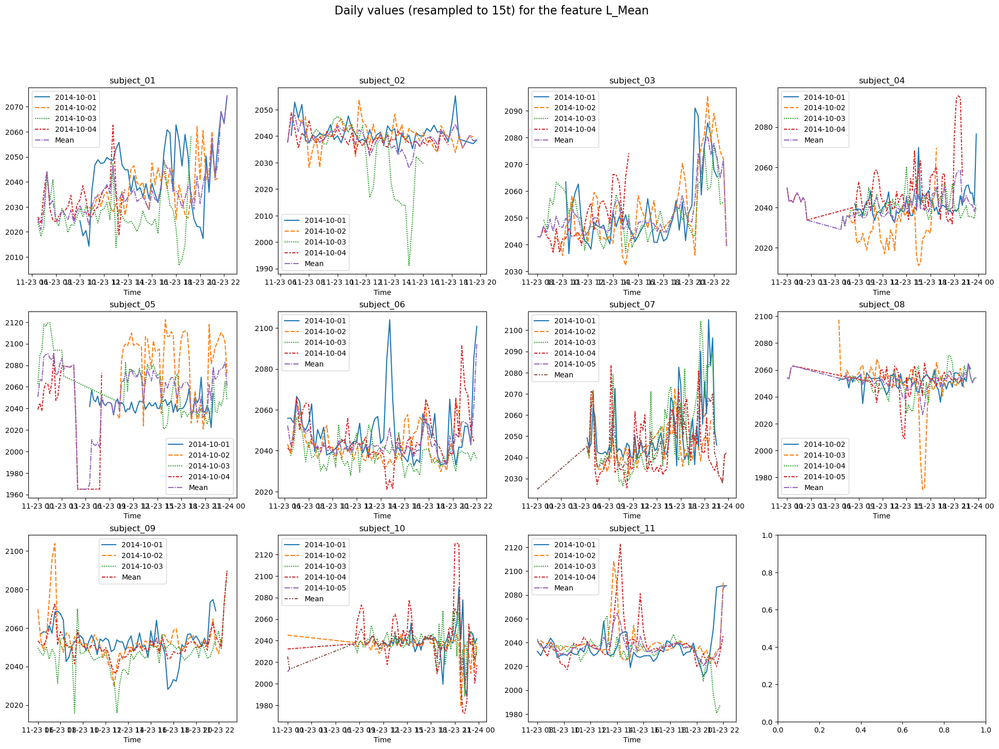

In [159]:
plot_fact_grid(L_Mean_df_dict, L_Mean_mean_values, "L_Mean")

In [130]:
S_Mean_df_dict, S_Mean_mean_values = create_df(file_dfs, "S_Mean")

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})


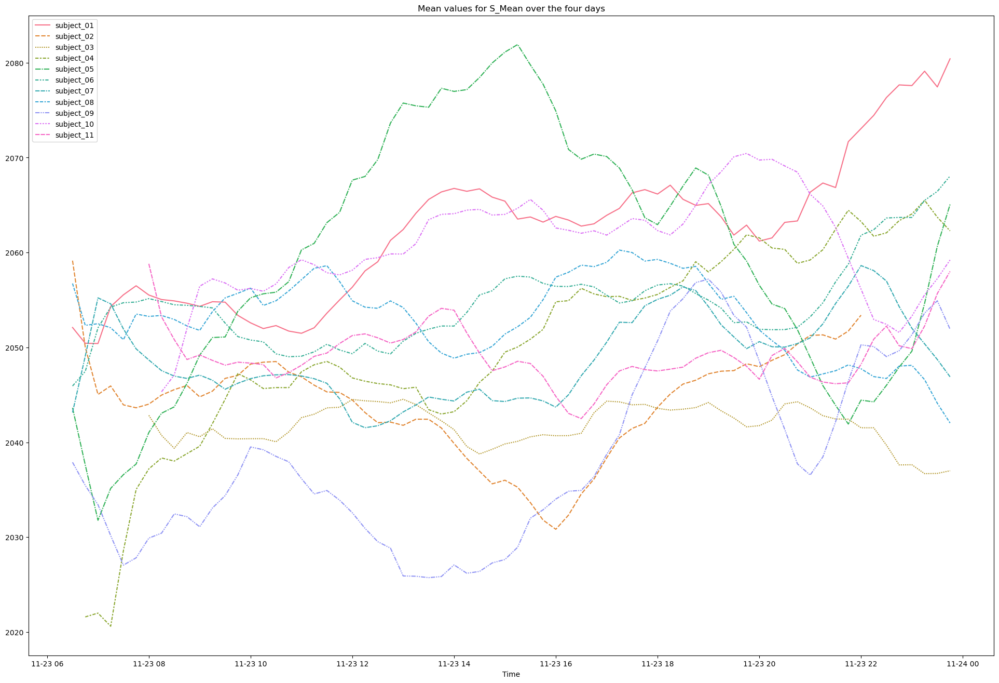

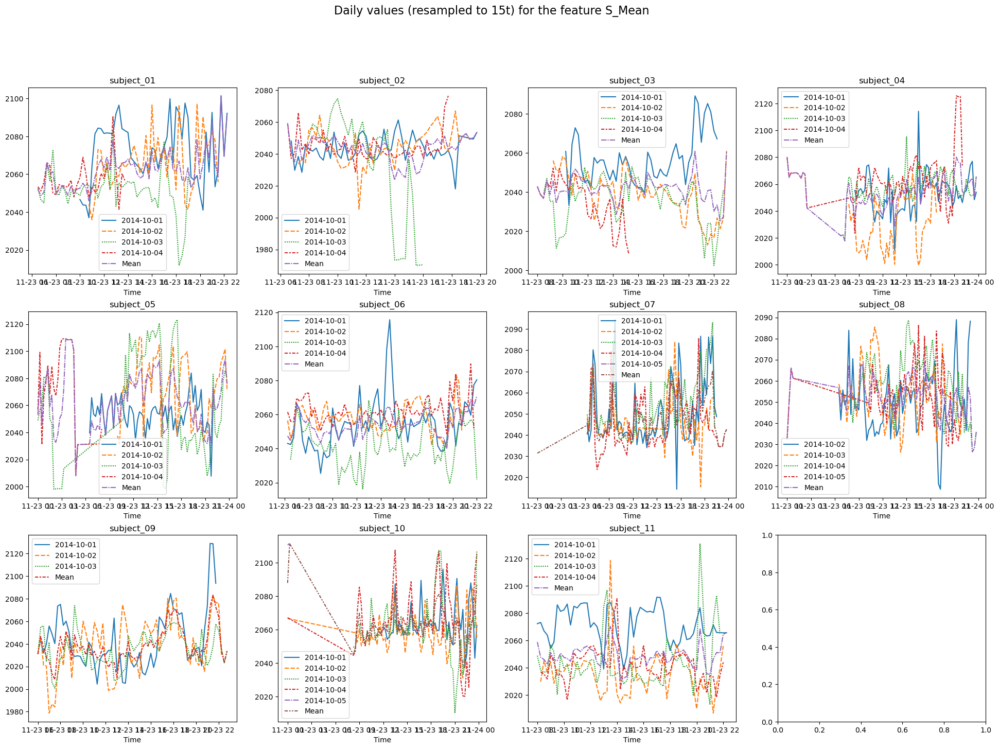

In [160]:
plot_fact_grid(S_Mean_df_dict, S_Mean_mean_values, "S_Mean")

In [132]:
V_STD_df_dict, V_STD_mean_values = create_df(file_dfs, "V_STD")

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})


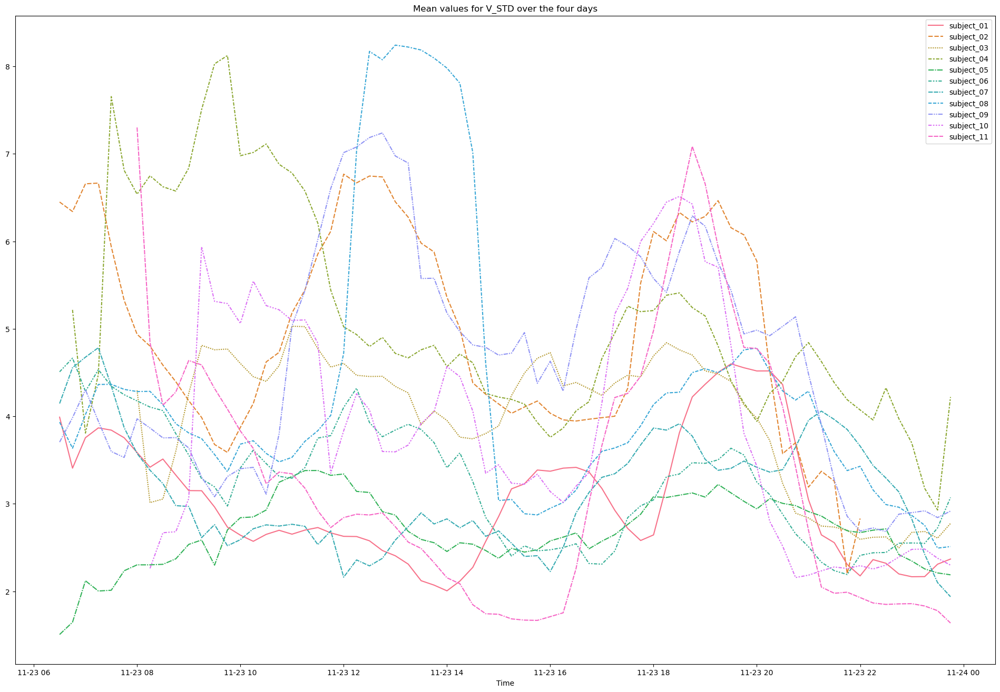

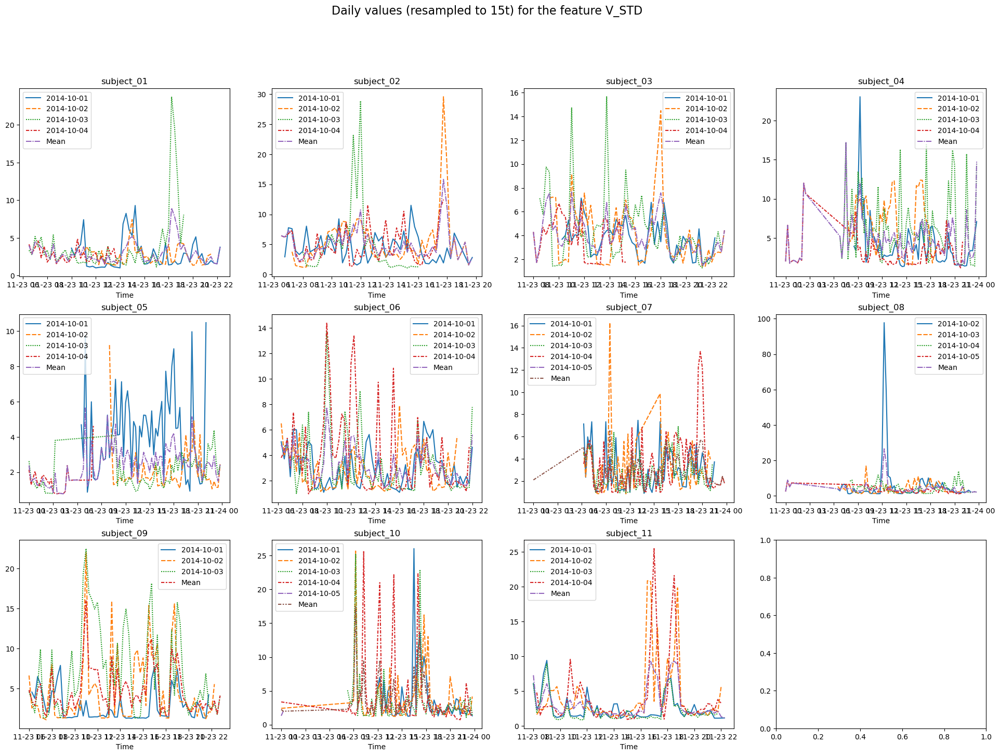

In [161]:
plot_fact_grid(V_STD_df_dict, V_STD_mean_values, "V_STD")

In [134]:
L_STD_df_dict, L_STD_mean_values = create_df(file_dfs, "L_STD")

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})


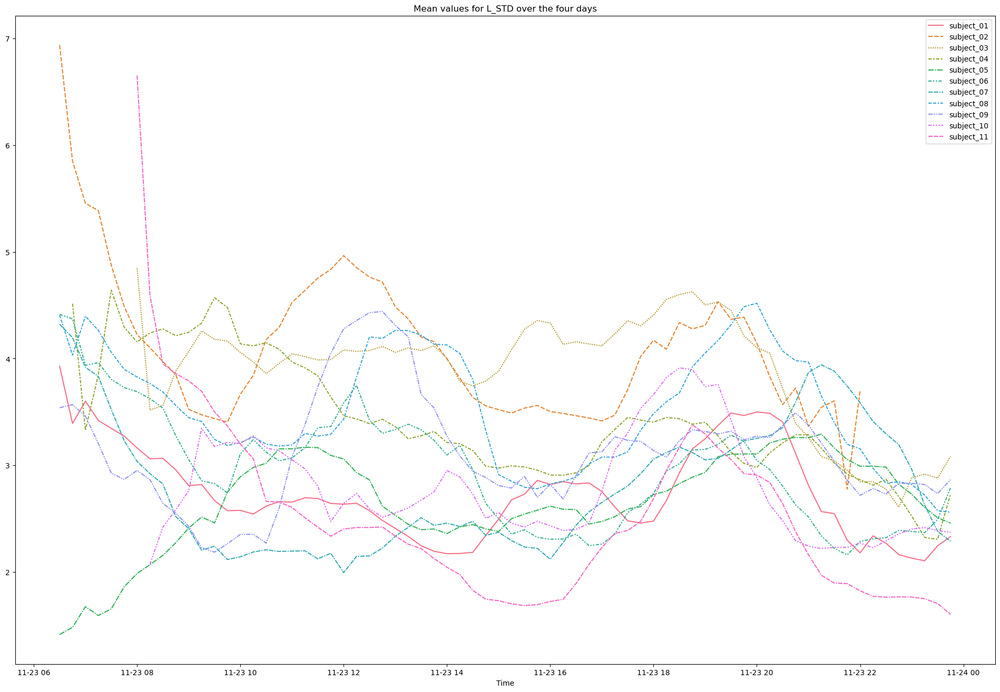

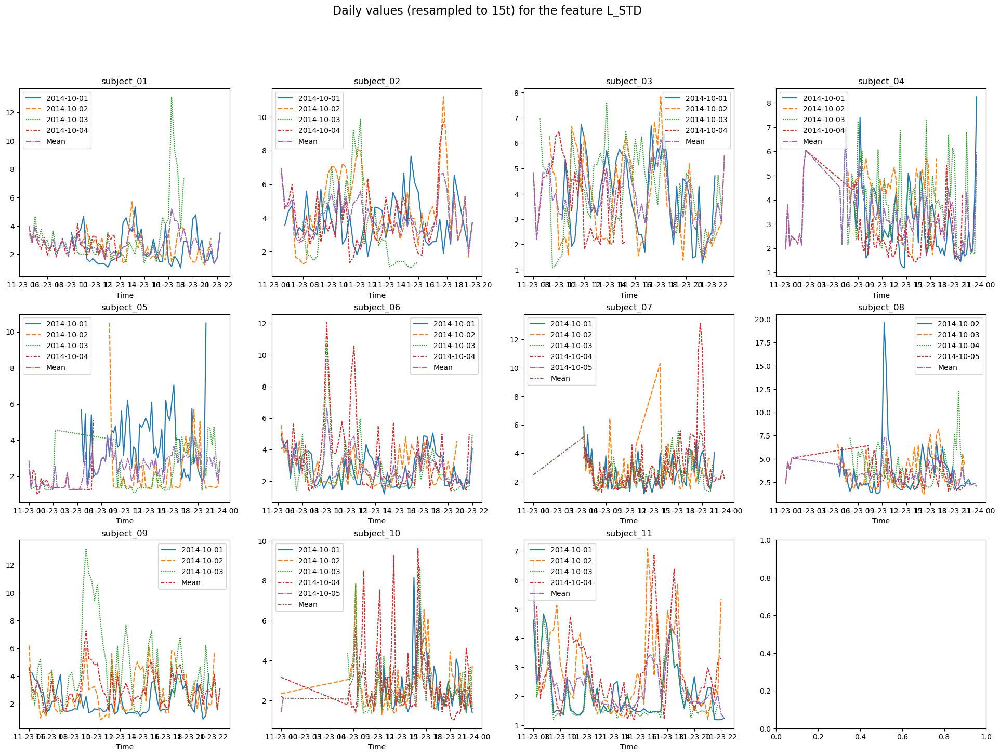

In [162]:
plot_fact_grid(L_STD_df_dict, L_STD_mean_values, "L_STD")

In [136]:
S_STD_df_dict, S_STD_mean_values = create_df(file_dfs, "S_STD")

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})


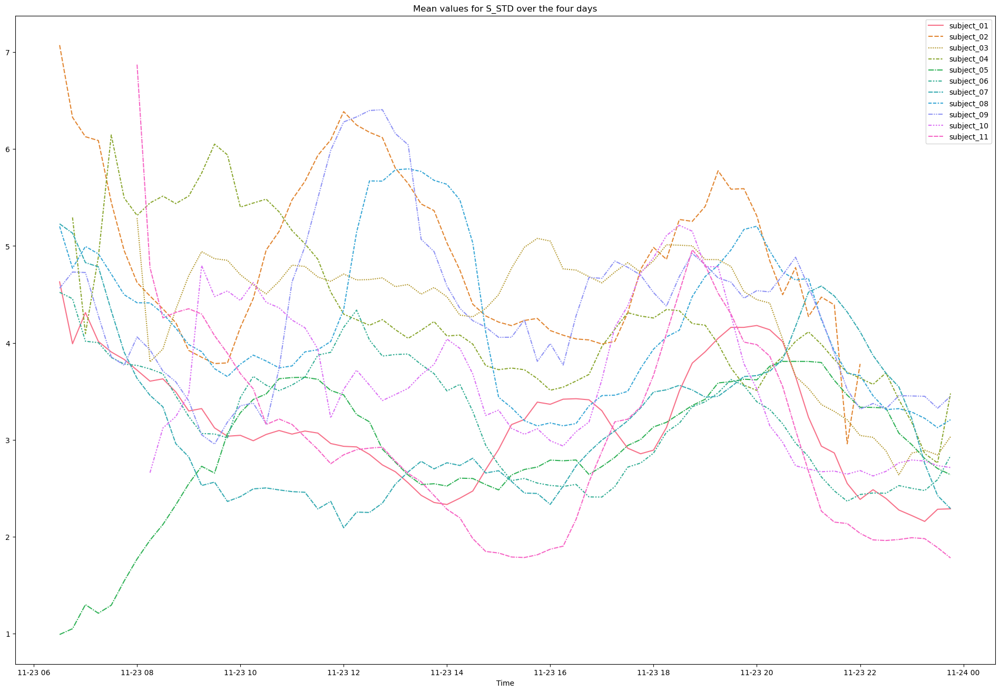

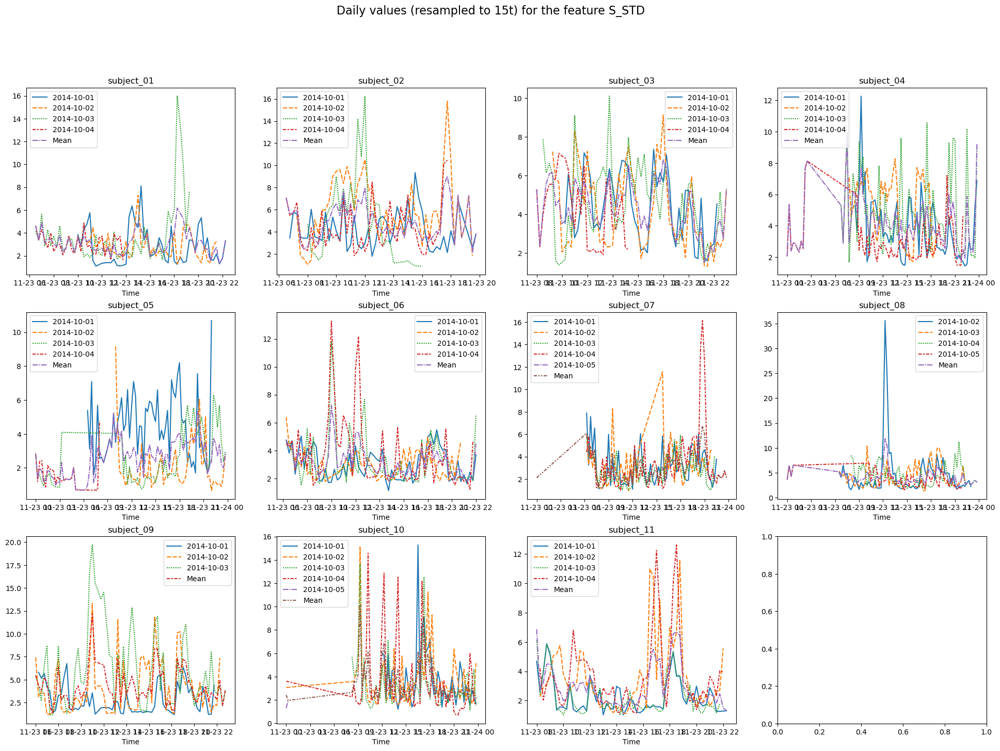

In [163]:
plot_fact_grid(S_STD_df_dict, S_STD_mean_values, "S_STD")

In [138]:
B_WF_Mean_df_dict, B_WF_mean_values = create_df(file_dfs, "B_WF_Mean")

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})


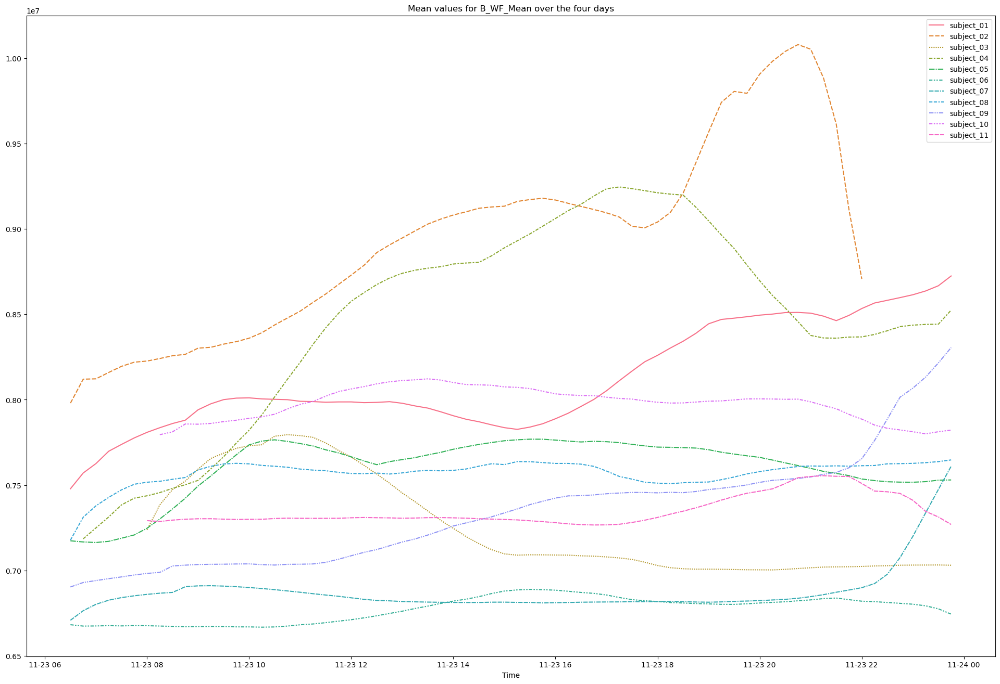

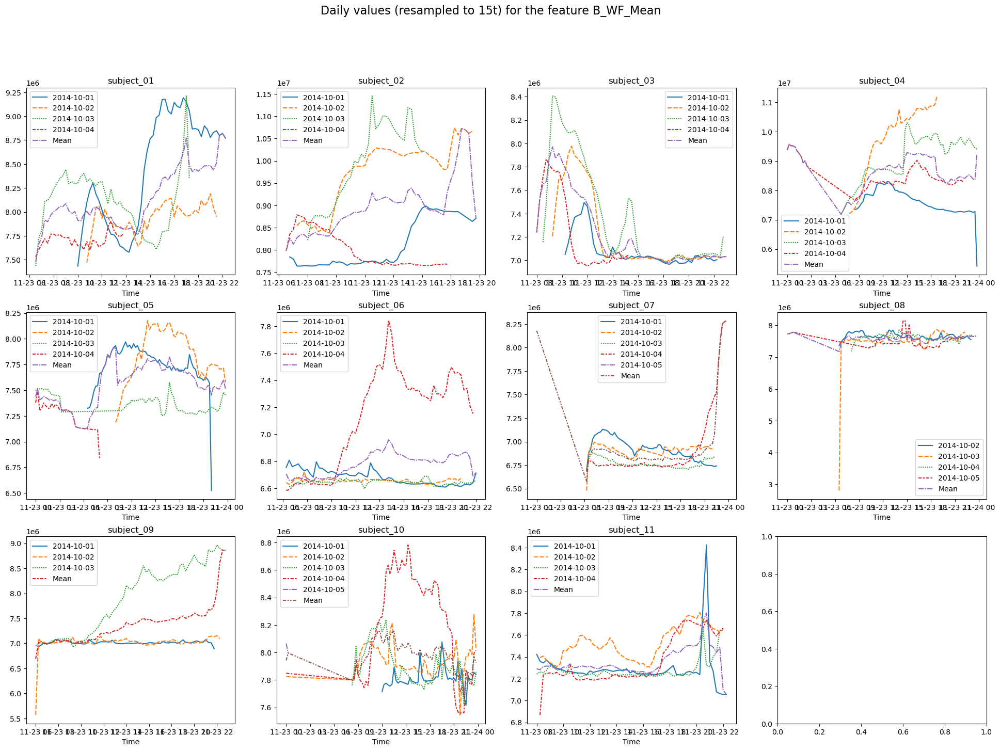

In [164]:
plot_fact_grid(B_WF_Mean_df_dict, B_WF_mean_values, "B_WF_Mean")

In [140]:
B_WF_STD_df_dict, B_WF_STD_values = create_df(file_dfs, "B_WF_STD")

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

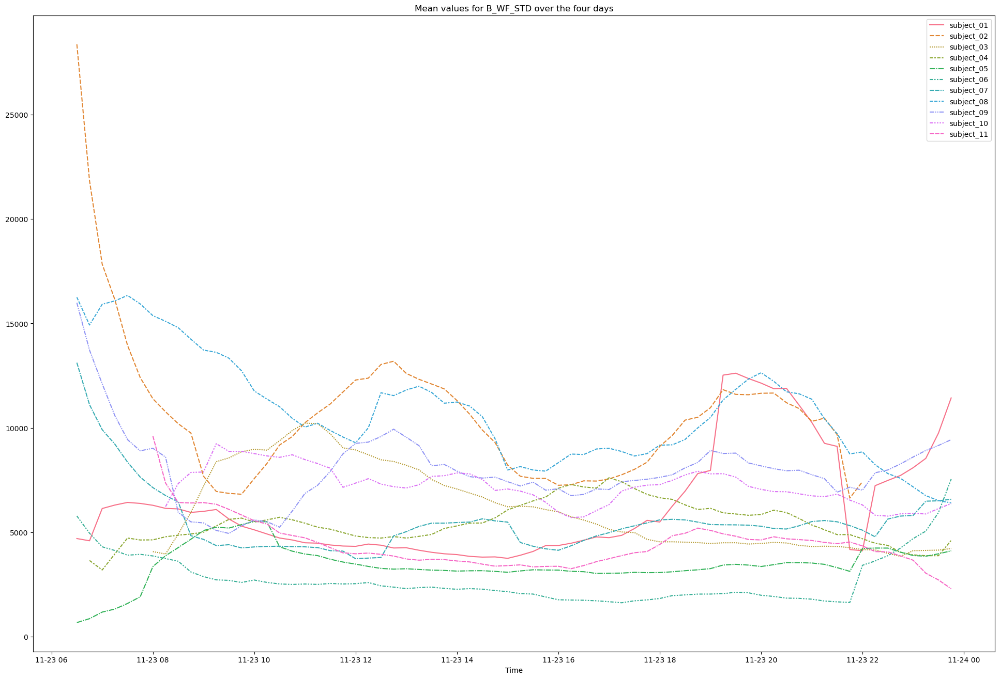

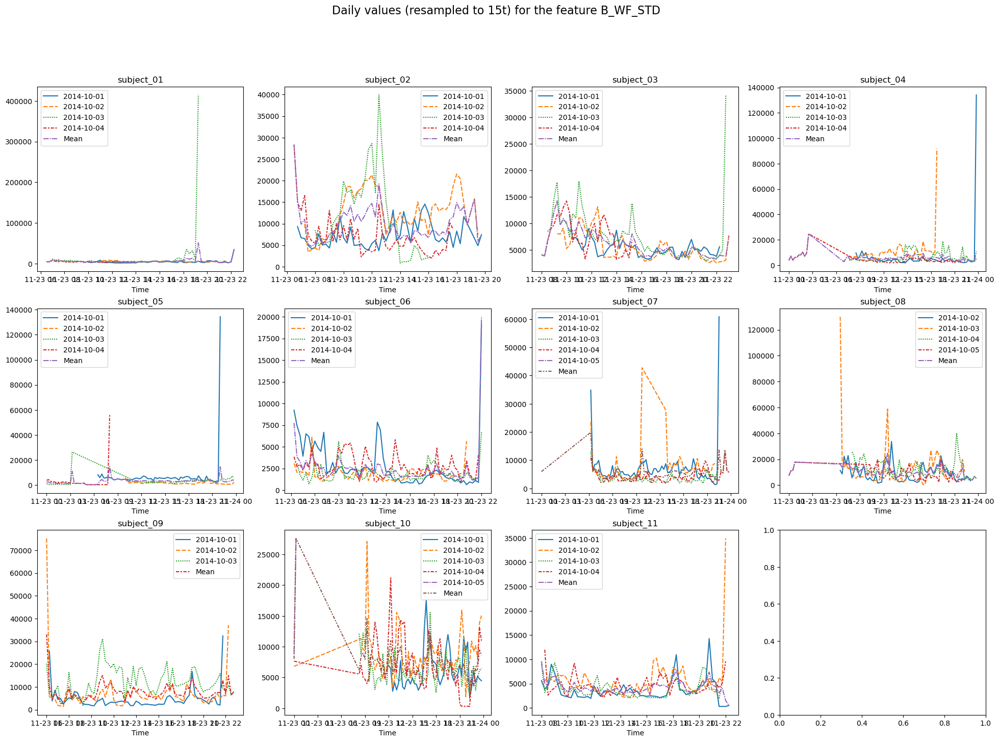

In [165]:
plot_fact_grid(B_WF_STD_df_dict, B_WF_STD_values, "B_WF_STD")

In [142]:
ECG_WF_Mean_df_dict, ECG_WF_Mean_values = create_df(file_dfs, "ECG_WF_Mean")

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})


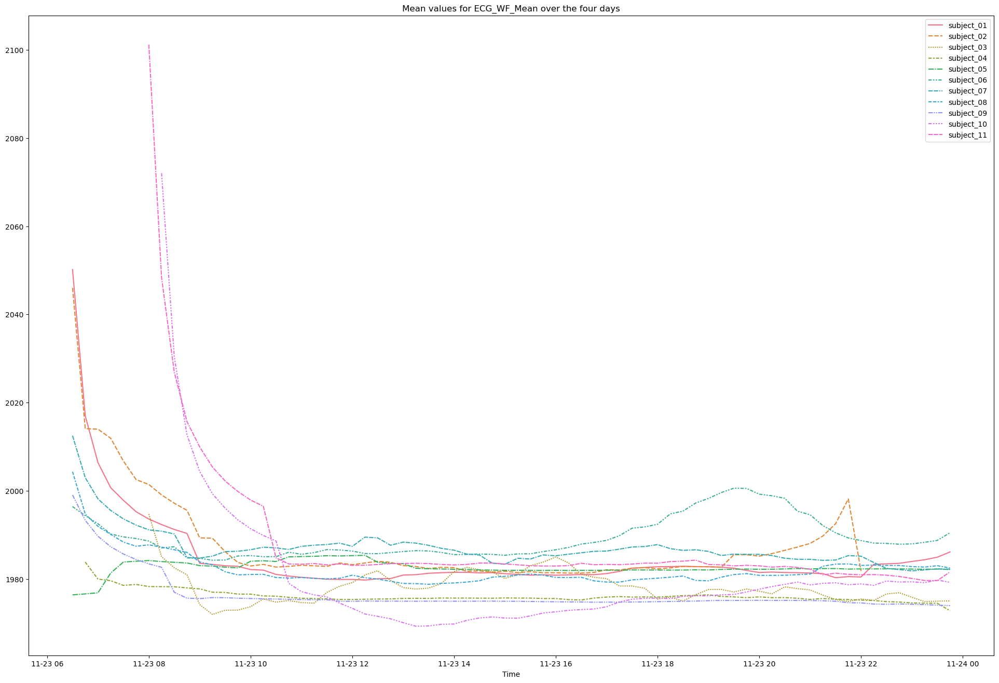

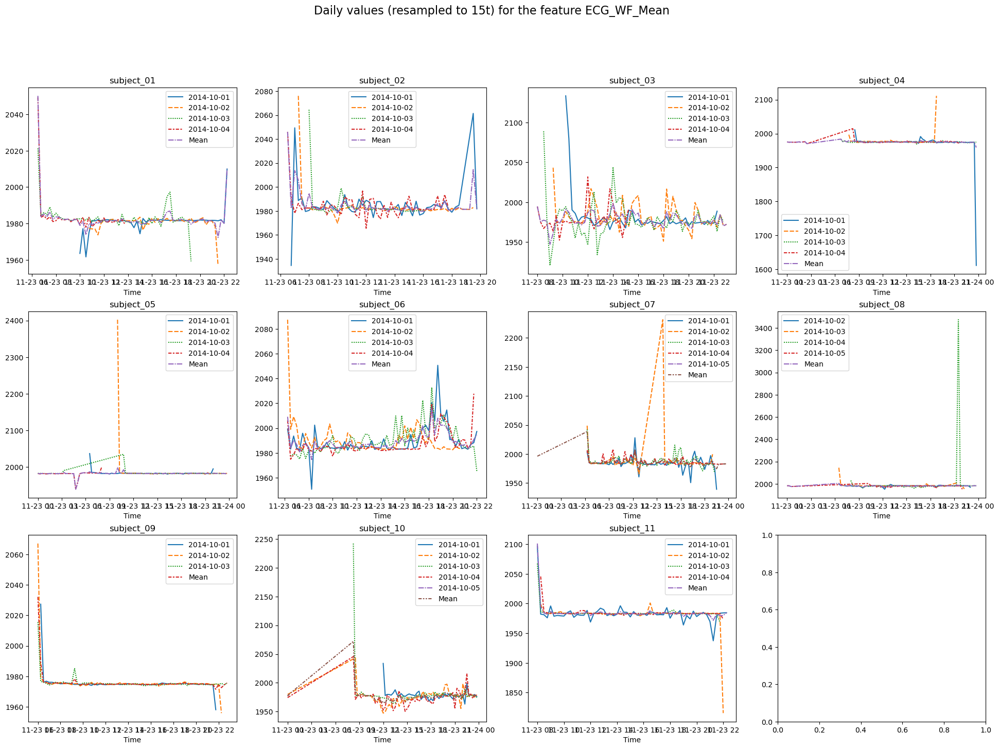

In [166]:
plot_fact_grid(ECG_WF_Mean_df_dict, ECG_WF_Mean_values, "ECG_WF_Mean")

In [144]:
ECG_WF_STD_df_dict, ECG_WF_STD_values = create_df(file_dfs, "ECG_WF_STD")

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be

C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})
C:\Users\PC\AppData\Local\Temp\ipykernel_10236\3759293400.py:9: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  current_df = file_dfs[df].set_index("Time")[[colName]][str(day.date())].rename(columns={colName:f"{day.date()}"})


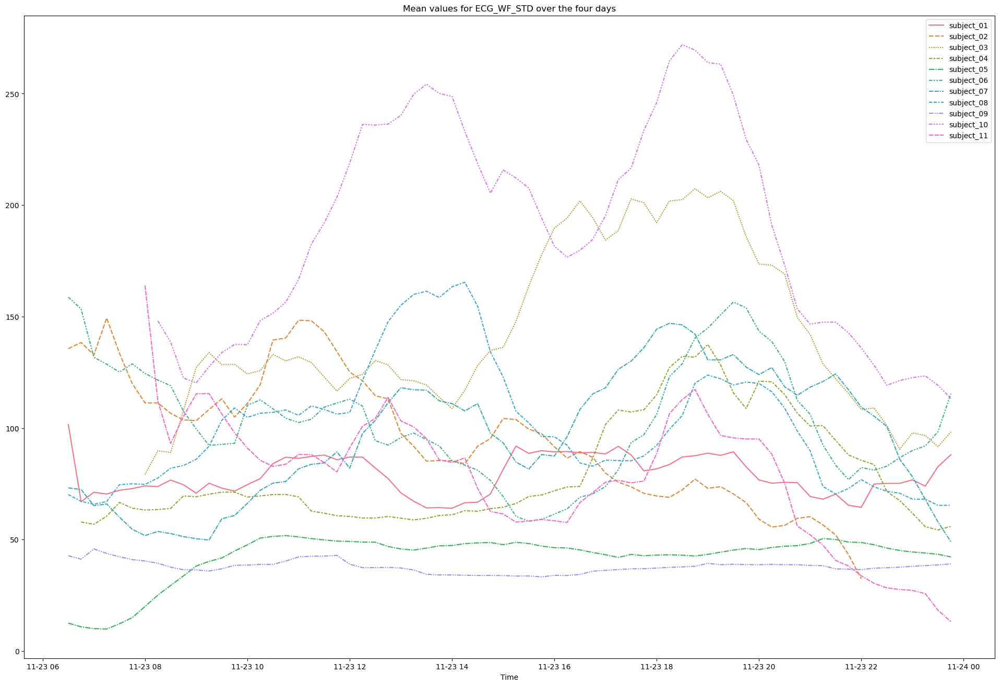

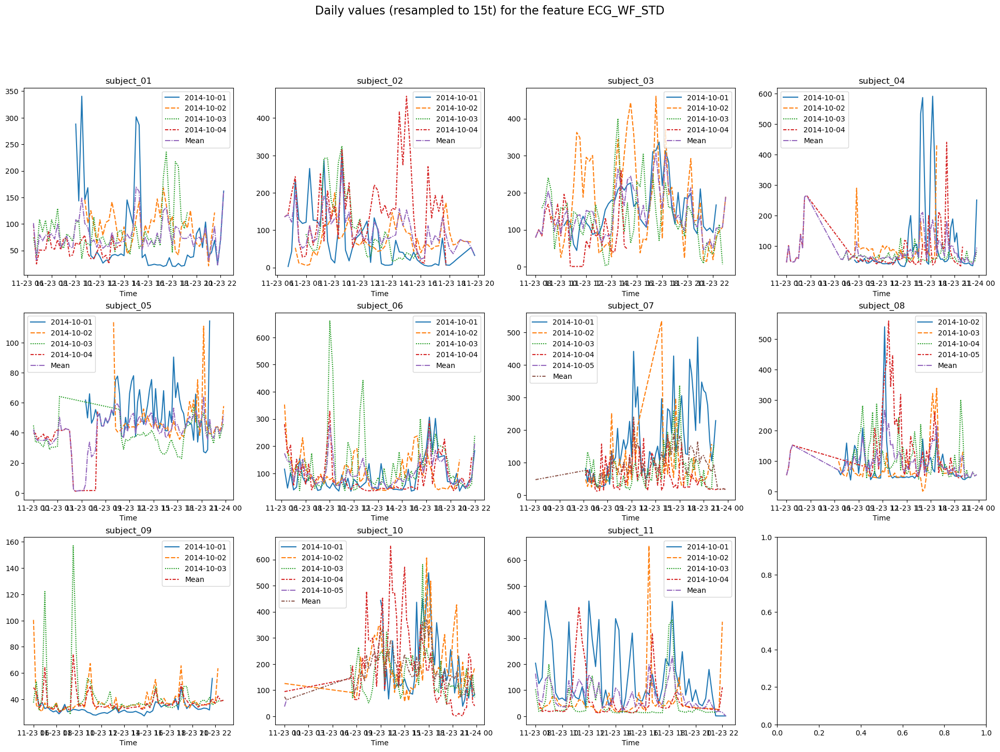

In [167]:
plot_fact_grid(ECG_WF_STD_df_dict, ECG_WF_STD_values, "ECG_WF_STD")